<a href="https://colab.research.google.com/github/lazy-wolf/TME_6017/blob/main/Assignment_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Assignment 3**

```
# Authoured by: Wasim Dawood Shaik
# UNB ID: 3744476
# D08e:419-02-2024
# Email: wasim.sk@unb.ca
```

# Import Libraries

In [ ]:
import time # For working with time-related functions.
import cv2 # OpenCV for image and video processing.
import numpy as np # NumPy for numerical operations and array handling.
import sys # Access to some variables used by the Python interpreter.
import os # For interacting with the operating system.
import torch # PyTorch, a deep learning framework.
from deep_sort_realtime.deepsort_tracker import DeepSort # DeepSort for real-time object tracking.
from ultralytics import YOLO # YOLO object detection from the Ultralytics package.
import matplotlib.pyplot as plt # Matplotlib for creating plots and visualizations.
# IPython magic to display plots inline in Jupyter notebooks.



In [ ]:
%matplotlib inline

# Research and Model Selection
In my exploration of deep learning models for object detection and tracking, I have conducted a comparative study of well-known architectures, including YOLO, SSD, and Faster R-CNN. After careful consideration of performance metrics, dataset compatibility, and real-time processing capabilities, the YOLOv5m6 model has been identified as the most suitable for the project's requirements. A detailed justification for this choice is provided within the document report.

# Data Collection and Preparation

# Dataset

In [ ]:
files = os.listdir("MOT16/train/MOT16-11/img1")

In [ ]:
len(files)

900

In [ ]:
files[:10]

['000001.jpg',
 '000002.jpg',
 '000003.jpg',
 '000004.jpg',
 '000005.jpg',
 '000006.jpg',
 '000007.jpg',
 '000008.jpg',
 '000009.jpg',
 '000010.jpg']

# Data Preprocessing

In [ ]:
def preprocessing(input_image):
    # Convert the input image from BGR to RGB color space. OpenCV loads images in BGR,
    # but most models expect RGB format.
    image = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)

    # Resize the image to a specific size (640x640 pixels) required by the model.
    # cv2.INTER_LINEAR is used for interpolation, a method that affects the quality of the upscaled or downscaled image.
    resized_image = cv2.resize(image, (640,640), interpolation=cv2.INTER_LINEAR)

    # Convert the resized image back to BGR color space from RGB. This conversion might be necessary if the next steps
    # in the processing pipeline or the model expects image data in BGR format.
    resized_image_bgr = cv2.cvtColor(resized_image, cv2.COLOR_RGB2BGR)

    # Return the preprocessed image in BGR format, now resized and ready for model input.
    return  resized_image_bgr

# Implementation

# Object Detection

In [ ]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5m6', pretrained=True)

Using cache found in C:\Users\wasim/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2024-4-8 Python-3.11.7 torch-2.2.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3070 Ti Laptop GPU, 8192MiB)

Fusing layers... 
YOLOv5m6 summary: 378 layers, 35704908 parameters, 0 gradients, 49.9 GFLOPs
Adding AutoShape... 


# Object Tracking

In [ ]:
object_tracker = DeepSort(
    max_age=30,  # The maximum number of frames to keep alive a track without receiving new matching detections.
                 # If a track does not get a matching detection for 30 consecutive frames, it will be terminated.

    n_init=3,    # The number of consecutive frames an object needs to be detected before considering it a confirmed track.
                 # This helps to avoid false positives by ensuring that an object is consistently detected before tracking.

    max_cosine_distance=0.3,  # The maximum cosine distance threshold for associating detections to tracks. A lower threshold
                              # requires detections and tracks to be more similar, which can reduce identity switches but may
                              # increase the number of track terminations if detections are noisy or inconsistent.

    embedder="mobilenet"  # Specifies the neural network used for feature extraction in the tracking algorithm.
                           # "mobilenet" is chosen here for its balance between accuracy and computational efficiency,
                           # making it suitable for real-time applications.
)

# Evaluation

# Deployment

In [ ]:
def filter_person_detections(label, cord_s, frame, height, width, confidence=0):
    # Assign labels and coordinates from arguments for clarity
    labels, cord = label, cord_s
    detections = []  # List to hold detections that pass the filter

    n = len(labels)  # Number of labels/detections
    x_shape, y_shape = width, height  # Image dimensions for scaling bounding box coordinates

    # Loop through each detection
    for i in range(n):
        row = cord[i]  # Current detection's bounding box and confidence

        # Only proceed if detection confidence is above the threshold
        if row[4] >= confidence:
            # Scale the bounding box coordinates to fit the image size
            x1, y1, x2, y2 = int(row[0] * x_shape), int(row[1] * y_shape), int(row[2] * x_shape), int(row[3] * y_shape)

            # Further process only 'person' detections
            if model.names[i] == 'person':
                # Bounding box dimensions and confidence for the current detection
                tlwh = np.asarray([x1, y1, int(x2 - x1), int(y2 - y1)], dtype=np.float32)
                detection_confidence = float(row[4].item())

                # Compile the detection information (bounding box, confidence, label)
                detections.append(([x1, y1, int(x2 - x1), int(y2 - y1)], detection_confidence, 'person'))

    # Return the unmodified frame and the filtered list of person detections
    return frame, detections

In [ ]:
video_path = "MOT16-11-raw.webm"

In [ ]:
cap = cv2.VideoCapture(video_path)

In [ ]:
frame_count = 0  # Initialize frame count to keep track of the number of frames processed.

# Start processing the video as long as it's open.
while cap.isOpened():
    succes, img = cap.read()  # Read the next frame from the video.
    frame_count += 1  # Increment frame count.

    if succes == True:
        start = time.perf_counter()  # Start timing for performance measurement.

        # Preprocess the frame for detection.
        img = preprocessing(img)

        # Perform object detection on the preprocessed frame.
        results = model(img)

        # Extract labels and coordinates of detected objects.
        labels, cord = results.xyxyn[0][:, -1], results.xyxyn[0][:, :-1]

        # Filter detections to only include persons with a confidence above 0.5.
        img, detections = filter_person_detections(labels, cord, img, height=img.shape[0], width=img.shape[1], confidence=0.5)

        # Update object tracks with the new detections.
        tracks = object_tracker.update_tracks(detections, frame=img)

        # Loop through each track to draw bounding boxes and annotate them.
        for track in tracks:
            if not track.is_confirmed():  # Skip unconfirmed tracks.
                continue

            track_id = track.track_id  # Track ID for annotation.
            ltrb = track.to_ltrb()  # Convert track to left, top, right, bottom format.
            bbox = ltrb

            # Draw the bounding box for the track.
            cv2.rectangle(img, (int(bbox[0]), int(bbox[1])), (int(bbox[2]), int(bbox[3])), (0, 0, 255), 2)

            # Annotate the bounding box with the track ID.
            cv2.putText(img, "ID: " + str(track_id), (int(bbox[0]), int(bbox[1] - 10)), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

            # Writing tracking result to the file
            with open("detection.txt", 'a') as output_file:
                for detection in detections:
                    formatted_line = f"{frame_count},{track_id},{bbox[0]},{bbox[1]},{bbox[2]-bbox[0]},{bbox[3]-bbox[1]},1,-1,-1,-1\n"
                    output_file.write(formatted_line)

        end = time.perf_counter()  # End timing after processing the frame.
        totalTime = end - start
        fps = 1 / totalTime  # Calculate frames per second (FPS).

        # Display the FPS on the frame.
        cv2.putText(img, f'FPS: {int(fps)}', (20, 70), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 2)

        # Display the resulting frame with bounding boxes and annotations.
        cv2.imshow('Frame', img)

        # Optionally, save the processed frame to an output file.
        cv2.imwrite(f'./output/output_{frame_count}.png', img)

        # Check for a 'q' key press to exit the loop.
        key = cv2.waitKey(25)
        if key == ord('q'):
            break
    else:
        break

# Release video capture and destroy any OpenCV windows after processing is complete.
cap.release()
cv2.destroyAllWindows()

# Performance Analysis

# Yolo Evaluation

In [ ]:
!yolo val model=yolov5m6.pt data=dataset.yaml

PRO TIP ðŸ’¡ Replace 'model=yolov5m6.pt' with new 'model=yolov5m6u.pt'.


val: Scanning C:\Users\wasim\Downloads\Assignment 3\annotate\labels.cache... 50 images, 0 backgrounds, 0 corrupt: 100%|##########| 50/50 [00:00<?, ?it/s]
val: Scanning C:\Users\wasim\Downloads\Assignment 3\annotate\labels.cache... 50 images, 0 backgrounds, 0 corrupt: 100%|##########| 50/50 [00:00<?, ?it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/4 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|##5       | 1/4 [00:04<00:12,  4.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|#####     | 2/4 [00:04<00:04,  2.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  75%|#######5  | 3/4 [00:05<00:01,  1.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|##########| 4/4 [00:05<00:00,  1.04it/s]
                 C


YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.

Ultralytics YOLOv8.1.45 ðŸš€ Python-3.11.7 torch-2.2.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3070 Ti Laptop GPU, 8192MiB)
YOLOv5m6u summary (fused): 323 layers, 41192992 parameters, 0 gradients, 65.3 GFLOPs
                   all         50        162      0.727      0.675      0.649      0.232
                person         50        162      0.727      0.675      0.649      0.232
Speed: 5.9ms preprocess, 32.0ms inference, 0.0ms loss, 16.1ms postprocess per image
Results saved to runs\detect\val2
ðŸ’¡ Learn more at https://docs.ultralytics.com/modes/val


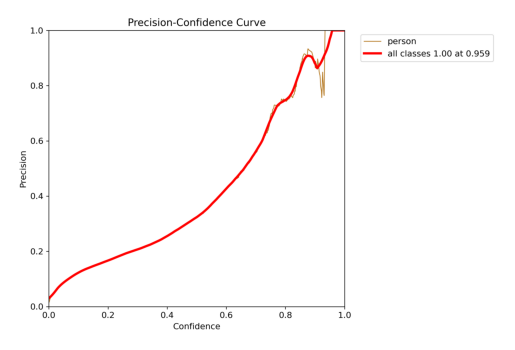

In [ ]:
# Read the precision-recall curve image.
precision_img = cv2.imread("./runs/detect/val/P_curve.png")

# Display the image with matplotlib.
plt.imshow(precision_img)

# Hide the axis for a cleaner look.
plt.axis('off')

# Show the image in the notebook.
plt.show()

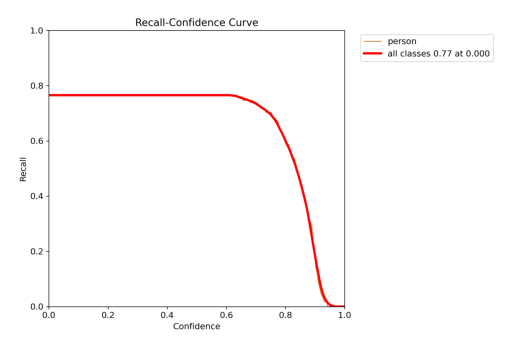

In [ ]:
# Load recall curve image.
recall_img = cv2.imread("./runs/detect/val/R_curve.png")
# Display image without axes.
plt.imshow(recall_img)
plt.axis('off')
plt.show()

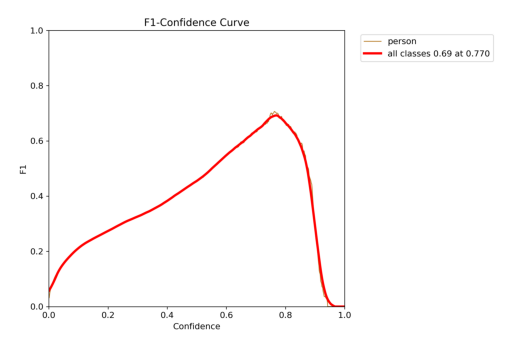

In [ ]:
# Load F1 score curve image.
f1_img = cv2.imread("./runs/detect/val/F1_curve.png")
# Load F1 score curve image.
plt.imshow(f1_img)
plt.axis('off')
plt.show()

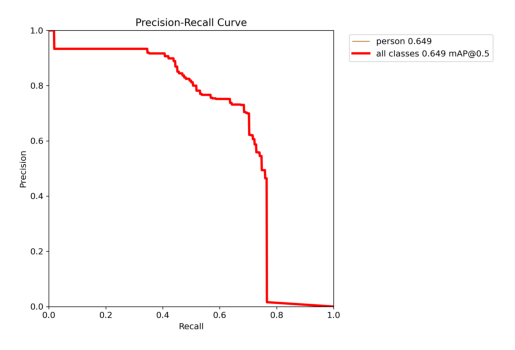

In [ ]:
# Load and display Precision-Recall curve image.
pr_img = cv2.imread("./runs/detect/val/PR_curve.png")
plt.imshow(pr_img)
plt.axis('off')
plt.show()

# Deepsort Evaluation


To assess the performance of the DeepSort Object Tracker, the MOT2016/2017 Evaluation Toolkit, accessible via the GitHub repository at https://github.com/shenh10/mot_evaluation, was employed. This toolkit facilitates a comprehensive analysis, offering insights into the tracker's efficiency and accuracy in a standardized manner.

# Deep Sort

In [ ]:
!python ./mot_evaluation/evaluate_tracking.py --seqmap "./MOT16/train/seqmap.txt" --track "./MOT16/train/" --gt "./MOT16/train"

[GT PREPROCESSING]: Removing non-people classes, remaining 9480/10076 boxes
[TRACK PREPROCESSING]: remove distractors and low visibility boxes,remaining 5699/5705 computed boxes
Distractors: 8, 9, 52, 53, 54, 74, 78
[GT PREPROCESSING]: Removing distractor boxes, remaining 9174/9480 boxes

****************************** MOT16-11 Evaluation ******************************
IDF1  IDP  IDR  | Rcll  Prcn  FAR   | GT   MT   PT   ML   | FP     FN     IDs   FM    | MOTA  MOTP  MOTAL
 54.6 71.3 44.3 |  58.2  93.6  0.40 |   69   15   25   29 |    363   3838    35    38 |  53.8  81.8  54.2




****************************** Summary Evaluation ******************************
IDF1  IDP  IDR  | Rcll  Prcn  FAR   | GT   MT   PT   ML   | FP     FN     IDs   FM    | MOTA  MOTP  MOTAL
 54.6 71.3 44.3 |  58.2  93.6  0.40 |   69   15   25   29 |    363   3838    35    38 |  53.8  81.8  54.2





# Output Images Data Visualization

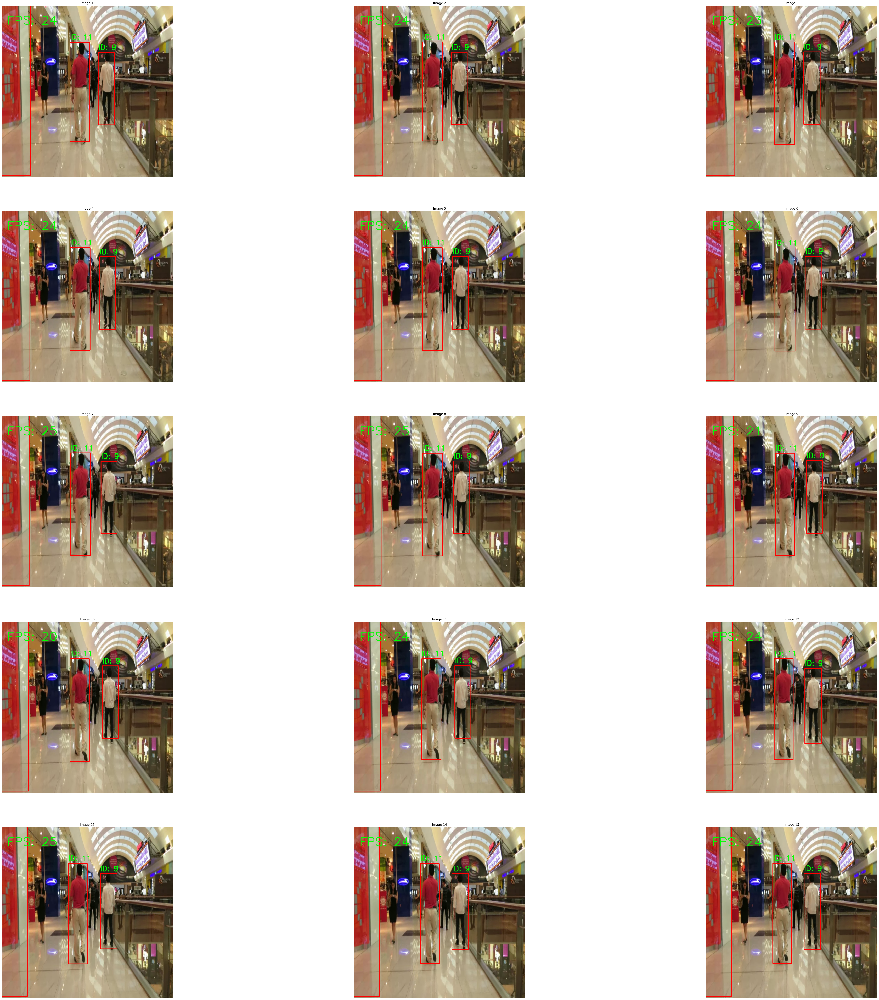

In [ ]:
# Specify the directory containing the output images
output_dir = './output_vis'

# List all files in the specified directory
all_files = os.listdir(output_dir)

# Filter for PNG files to get only images
output_images = [os.path.join(output_dir, file) for file in all_files if file.endswith('.png')]

# Set up the figure size for displaying images
plt.figure(figsize=(75, 75))

# Loop through the filtered list of image files
for i, filename in enumerate(output_images):
    # Read each image using OpenCV
    img = cv2.imread(filename)

    # Convert the color of the image from BGR (default in OpenCV) to RGB (for correct matplotlib display)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Add a subplot for each image in a grid layout of 5 rows x 6 columns
    plt.subplot(5, 3, i + 1)

    # Display the RGB image in the current subplot
    plt.imshow(img_rgb)

    # Set the title of the subplot to indicate the image number
    plt.title(f"Image {i+1}")

    # Turn off axis labels and ticks for a cleaner look
    plt.axis('off')

# Display all the subplots as a single figure
plt.show()